In [ ]:
import pickle
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import os
import cv2
from sklearn.metrics import confusion_matrix
import itertools
import tensorflow as tf

In [2]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras import callbacks
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dropout, Dense, LeakyReLU, BatchNormalization
import tensorflow_datasets as tfds
import tensorflow.keras as keras
import tensorflow as tf

In [3]:
image_size = (224, 224, 3)

In [4]:
def plot_confusion_matrix(cm, classes=[],
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues, figsize_val=6.5):

    fig=plt.figure(figsize=(figsize_val,figsize_val))
    plt.imshow(cm, interpolation='none', cmap=cmap)
    plt.title(title)
    plt.colorbar(fraction=0.046, pad=0.04)
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45,ha='right')
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [5]:
# Função de predict de uma rede neuronal

def predict_func(cnn, test_gen, classes_in=[], size=3704, bSize=10, figsize_val=6.5, verbose=True):
    NTakes = size / bSize
    n = 0

    # true class
    Y = np.array([])
    # predicted
    Y2 = np.array([])

    for I, y in test_gen:

        Y = np.hstack((Y, np.argmax(y, axis=1)))
        y2 = cnn.predict(I, verbose=1 if verbose else 0)
        Y2 = np.hstack((Y2, np.argmax(y2, axis=1)))

        # Stopping criteria
        n += 1
        if n > NTakes:
            break
        if verbose:
            print(".", end="")

    if verbose:
        print("\n")
        
    M = confusion_matrix(Y, Y2)
    
    a = "%d erros em %d exemplos" % (np.sum(Y != Y2), Y.shape[0])
    b = "Accuracy: " + str(round(100 - np.sum(Y != Y2) * 100 / Y.shape[0], 2))
    
    plot_confusion_matrix(M, classes=classes_in, figsize_val=figsize_val, title='Confusion matrix: ' + '\n' + str(b) + '\n' + str(a))

    if verbose:
        print(a)
        print(b)
    
    return Y, Y2


In [6]:
D = pickle.load(open('./data/Oxford-IIIT-Pet_Dics.p', 'rb'))
print(D.keys())
fD = D['filesDic']
k = list(fD.keys())
print(k[:10])
print(fD[k[0]])

dict_keys(['classDic', 'filesDic'])
['Abyssinian_1.jpg', 'Abyssinian_10.jpg', 'Abyssinian_100.jpg', 'Abyssinian_101.jpg', 'Abyssinian_102.jpg', 'Abyssinian_103.jpg', 'Abyssinian_104.jpg', 'Abyssinian_105.jpg', 'Abyssinian_106.jpg', 'Abyssinian_107.jpg']
{'species': 'cat', 'breed': 'Abyssinian', 'target': 25, 'imgDim': (400, 600, 3), 'bndBox': [333, 72, 92, 86], 'foldTrain': True}


In [7]:
def addAndReturn(dictionary, index):
    dictionary['index'] = index
    return dictionary

In [8]:
# Get unique species from fD
unique_breeds = np.unique(np.array([fD[k]['breed'] for k in fD]))
classes = np.arange(len(unique_breeds))
print(unique_breeds)

# Get the index of the breed in the unique_breeds array
breed_to_idx = {unique_breeds[i]: i for i in range(len(unique_breeds))}
# print(breed_to_idx['Abyssinian'])

['Abyssinian' 'Bengal' 'Birman' 'Bombay' 'British_Shorthair'
 'Egyptian_Mau' 'Maine_Coon' 'Persian' 'Ragdoll' 'Russian_Blue' 'Siamese'
 'Sphynx' 'american_bulldog' 'american_pit_bull_terrier' 'basset_hound'
 'beagle' 'boxer' 'chihuahua' 'english_cocker_spaniel' 'english_setter'
 'german_shorthaired' 'great_pyrenees' 'havanese' 'japanese_chin'
 'keeshond' 'leonberger' 'miniature_pinscher' 'newfoundland' 'pomeranian'
 'pug' 'saint_bernard' 'samoyed' 'scottish_terrier' 'shiba_inu'
 'staffordshire_bull_terrier' 'wheaten_terrier' 'yorkshire_terrier']


In [9]:
# Get only the elements that have foldTrain = True
train_files = np.array([addAndReturn(fD[k], k) for k in fD if fD[k]['foldTrain']])
test_files = np.array([addAndReturn(fD[k], k) for k in fD if not fD[k]['foldTrain']])
y_train_m = np.array([breed_to_idx[k['breed']] for k in train_files])

#train_files, val_files = train_test_split(train_files, test_size=.1,stratify=y_train_b)
train_files, val_files = train_test_split(train_files, test_size=.1,stratify=y_train_m)


print("Ficheiros de treino:", train_files.shape, )
print("Ficheiros de validação:", val_files.shape)
print("Ficheiros de teste:", test_files.shape)

Ficheiros de treino: (3317,)
Ficheiros de validação: (369,)
Ficheiros de teste: (3704,)


In [ ]:
D = pickle.load(open("./data/Oxford-IIIT-Pet_Dics.p","rb"))

classDic = D['classDic']
filesDic = D['filesDic']
del D # delete D to free memory

def createFolders(classDic):
    """
    Creates the folders to store the images
    """
    for breed in list(classDic.keys()):
        # Breeds
        trainPath = os.path.join('./breeds/train/' + breed)
        if not os.path.exists(trainPath):
            os.makedirs('./breeds/train/' + breed)

        testPath = os.path.join('./breeds/test/' + breed)
        if not os.path.exists(testPath):
            os.makedirs('./breeds/test/' + breed)
            
        testPath = os.path.join('./breeds/valitation/' + breed)
        if not os.path.exists(testPath):
            os.makedirs('./breeds/validation/' + breed)


def splitData(filesDic, train_files, val_files, test_files):
    i = 1
    size = len(list(filesDic.keys()) )
    for imgName in list(filesDic.keys()):
        
        img = keras.preprocessing.image.load_img('./data/images2/' + imgName)
        foldTrain = filesDic.get(imgName).get('foldTrain')

        path = 'breeds'
        if 'breed' in filesDic.get(imgName).keys():
            print("img", filesDic.get(imgName).get(str('breed')))
            p = './' + str(path) +'/' + ('train/' if foldTrain else ('test/' if true else 'validation/')) + filesDic.get(imgName).get(str('breed')) +  '/' + imgName
            keras.preprocessing.image.save_img(p, img)
        
        else:
            print("Erro:", "breed")


createFolders(classDic)

splitData(filesDic, train_files, val_files, test_files) # Multi-class classification3

In [12]:
size = (image_size[0], image_size[1])


batch_size_train=31
batch_size_val=41
batch_size_test=8
epochs = 100

In [13]:
train_gen = ImageDataGenerator(rotation_range = 30,
                               width_shift_range = 0.1,
                               height_shift_range = 0.1,
                               shear_range = 0.1,
                               zoom_range = 0.1,
                               horizontal_flip = True,
                               fill_mode = 'nearest',
                               rescale=1.0/255.0)

In [14]:
data_gen = ImageDataGenerator(rescale=1.0/255.0)

In [15]:
multiclass_folder = './breeds/'
test_folder = "test"
train_folder = "train"
val_folder = "validation"
# Multiclass


train_gen_m = train_gen.flow_from_directory(directory = multiclass_folder + train_folder +"/",
                                     target_size = size, class_mode="categorical", batch_size=batch_size_train, shuffle = True)

valid_gen_m = data_gen.flow_from_directory(directory = multiclass_folder + val_folder + "/",
                                     target_size = size, class_mode="categorical", batch_size=batch_size_val, shuffle = True)

test_gen_m = data_gen.flow_from_directory(directory = multiclass_folder + test_folder + "/", 
                                    target_size = size, class_mode="categorical", batch_size=batch_size_test, shuffle=False)

Found 3680 images belonging to 37 classes.
Found 1000 images belonging to 37 classes.
Found 3704 images belonging to 37 classes.


In [16]:
from tensorflow.keras import Sequential
# Add callback
my_callbacks = [
    tf.keras.callbacks.EarlyStopping(patience=10,monitor="val_loss",verbose=1,restore_best_weights=True)
]

In [18]:
from tensorflow.keras.layers import (Activation, Dropout, Flatten, Dense, GlobalMaxPooling2D,BatchNormalization, Input, Conv2D, GlobalAveragePooling2D,AveragePooling2D)
from tensorflow.keras.applications import ResNet50V2
resnet=ResNet50V2(include_top=False,  input_shape=(image_size[0], image_size[1], 3))
resnet.trainable=False

cnnnBase = keras.applications.mobilenet_v2.MobileNetV2(
    weights='imagenet', include_top=False,  input_shape=(image_size[0], image_size[1], 3)
)
# Creating the model for binary classification of dogs and cats
multi_cnn_resnet = Sequential([
    resnet,
    AveragePooling2D(pool_size=(7, 7),strides=(7, 7)),
    Flatten(),
    Dense(1024, activation='relu'),
    Dropout(0.5),
    Dense(1024, activation='relu'),
    Dropout(0.5),
    Dense(len(unique_breeds), activation='softmax')
])

# Compiling the model
multi_cnn_resnet.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
#multi_cnn_resnet.save_weights('model_multi_resnet.h5')
#multi_cnn_resnet.summary()

In [18]:
multi_cnn_resnet.fit(train_gen_m,
                     epochs=epochs, 
                     steps_per_epoch=107, 
                     validation_data=valid_gen_m, 
                     validation_steps=100, 
                     callbacks=my_callbacks)

Epoch 1/100


C:\Users\fafe\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


107/107 ━━━━━━━━━━━━━━━━━━━━ 99s 868ms/step - accuracy: 0.3622 - loss: 2.5478 - val_accuracy: 0.8559 - val_loss: 0.4421
Epoch 2/100


C:\Users\fafe\anaconda3\Lib\contextlib.py:155: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


107/107 ━━━━━━━━━━━━━━━━━━━━ 19s 178ms/step - accuracy: 0.6670 - loss: 1.1307 - val_accuracy: 0.8702 - val_loss: 0.4304
Epoch 3/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 87s 802ms/step - accuracy: 0.7271 - loss: 0.8815 - val_accuracy: 0.8902 - val_loss: 0.3492
Epoch 4/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 19s 176ms/step - accuracy: 0.7377 - loss: 0.9143 - val_accuracy: 0.8716 - val_loss: 0.4117
Epoch 5/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 82s 747ms/step - accuracy: 0.7525 - loss: 0.7823 - val_accuracy: 0.8916 - val_loss: 0.3191
Epoch 6/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 19s 170ms/step - accuracy: 0.8209 - loss: 0.6072 - val_accuracy: 0.8973 - val_loss: 0.2905
Epoch 7/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 82s 756ms/step - accuracy: 0.8115 - loss: 0.5901 - val_accuracy: 0.9301 - val_loss: 0.2429
Epoch 8/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 19s 170ms/step - accuracy: 0.7778 - loss: 0.8238 - val_accuracy: 0.8987 - val_loss: 0.2485
Epoch 9/100
107/107 ━━━━━━━━━━━━━━━━━━━━ 82s 748ms/step - accuracy: 0.8097 - loss: 0.649

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step




(array([0., 0., 0., ..., 0., 0., 0.]), array([0., 0., 0., ..., 0., 5., 0.]))

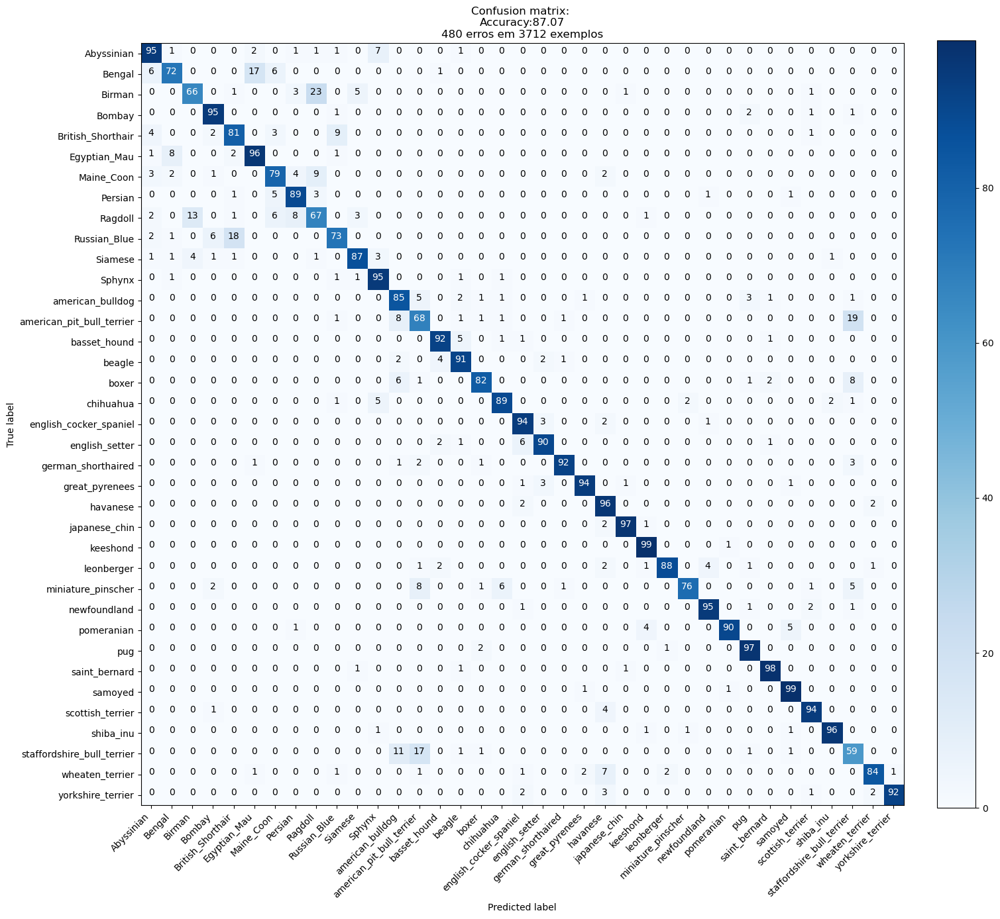

In [19]:
predict_func(multi_cnn_resnet, test_gen_m,unique_breeds, size=test_gen_m.n, bSize=batch_size_test, figsize_val=15)

In [23]:
# Save only the model weights with the expected extension
multi_cnn_resnet.save_weights('custom_cnn_model.weights.h5')


In [19]:
# Recreate the model architecture
custom_cnn_model = Sequential([
    resnet,
    AveragePooling2D(pool_size=(7, 7), strides=(7, 7)),
    Flatten(),
    Dense(1024, activation='relu'),
    Dropout(0.5),
    Dense(1024, activation='relu'),
    Dropout(0.5),
    Dense(len(unique_breeds), activation='softmax')
])

# Manually build the model by providing an input shape or calling build()
custom_cnn_model.build(input_shape=(None, image_size[0], image_size[1], 3))

# Load the previously saved weights
custom_cnn_model.load_weights('custom_cnn_model.weights.h5')

# Compile the model again
custom_cnn_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


(array([0., 0., 0., ..., 0., 0., 0.]), array([0., 0., 0., ..., 0., 5., 0.]))

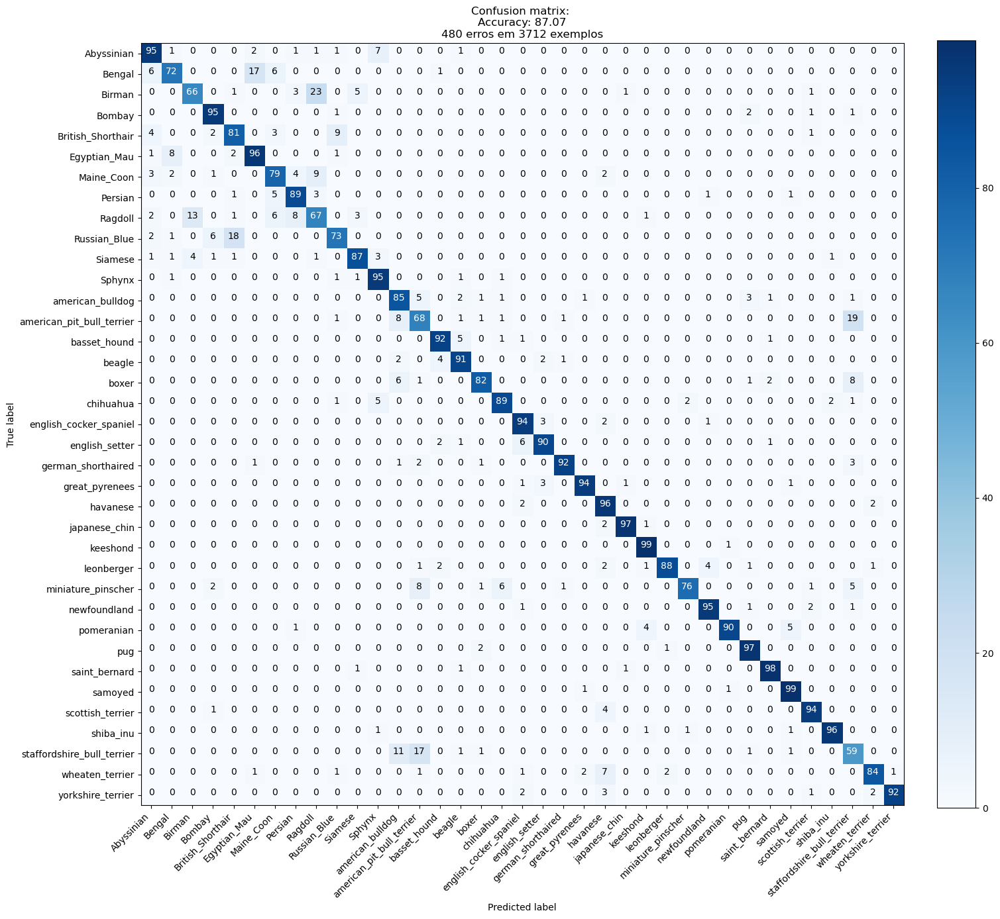

In [20]:
predict_func(custom_cnn_model, 
             test_gen_m, 
             classes_in=unique_breeds, 
             size=test_gen_m.n, 
             bSize=batch_size_test, 
             figsize_val=15, 
             verbose=False)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


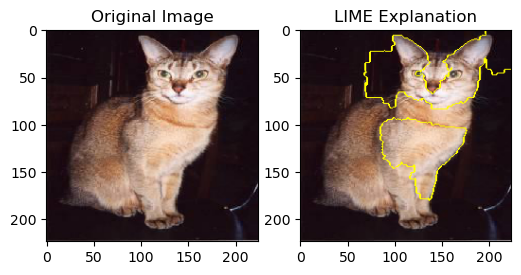

In [24]:
import numpy as np
import lime
import lime.lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Assuming cnn is your trained model and test_gen provides test images
# First, take a single image from the test data
I, y = next(test_gen_m)
image = I[0]  # Let's explain the first image

# Normalize image for LIME
image = np.expand_dims(image, axis=0)

# Initialize the LIME ImageExplainer
explainer = lime.lime_image.LimeImageExplainer()

# Define a function that takes an image and returns the prediction
def predict_fn(images):
    return custom_cnn_model.predict(images, verbose=0)

# Generate explanation for the image
explanation = explainer.explain_instance(image[0], 
                                         predict_fn, 
                                         top_labels=5,  # Number of top classes to explain
                                         hide_color=0,  # Color to use for superpixels that are not being perturbed
                                         num_samples=1000)  # Number of samples for LIME to generate

# Choose the class to explain
label_to_explain = np.argmax(custom_cnn_model.predict(image))

# Get the superpixel-based explanation
temp, mask = explanation.get_image_and_mask(label_to_explain, positive_only=True, num_features=5, hide_rest=False)

# Display the original image and the superpixels contributing to the decision
plt.figure(figsize=(6, 6))
plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(image[0])

plt.subplot(1, 2, 2)
plt.title('LIME Explanation')
plt.imshow(mark_boundaries(temp, mask))
plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


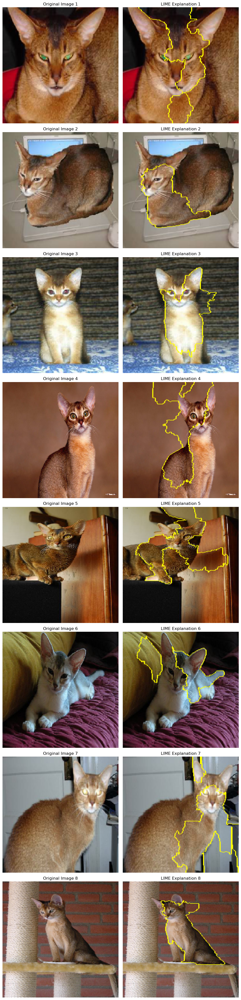

In [25]:
import numpy as np
import lime
import lime.lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt

# Get a batch of images from your test generator
I, y = next(test_gen_m)  # Assuming test_gen yields a batch of images

# Initialize the LIME ImageExplainer
explainer = lime.lime_image.LimeImageExplainer()

# Define a function that takes an image and returns the prediction
def predict_fn(images):
    return custom_cnn_model.predict(images, verbose=0)

# Create a figure to hold the subplots for 8 images (2 columns: original + explanation)
fig, axes = plt.subplots(8, 2, figsize=(10, 40))  # 8 rows and 2 columns

# Loop through the first 8 images from the batch
for i in range(8):
    image = I[i]  # Select the i-th image from the batch
    image_expanded = np.expand_dims(image, axis=0)  # Expand dimensions for the model
    
    # Generate explanation for the current image
    explanation = explainer.explain_instance(image, 
                                             predict_fn, 
                                             top_labels=5, 
                                             hide_color=0, 
                                             num_samples=1000)
    
    # Choose the label to explain (the predicted class for the current image)
    label_to_explain = np.argmax(custom_cnn_model.predict(image_expanded))
    
    # Get the image and mask for LIME explanation
    temp, mask = explanation.get_image_and_mask(label_to_explain, positive_only=True, num_features=5, hide_rest=False)
    
    # Plot the original image in the left column
    axes[i, 0].imshow(image)
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the LIME explanation in the right column
    axes[i, 1].imshow(mark_boundaries(temp, mask))
    axes[i, 1].set_title(f"LIME Explanation {i+1}")
    axes[i, 1].axis('off')  # Turn off axis for a cleaner look

# Adjust the layout so that it looks nice
plt.tight_layout()
plt.show()


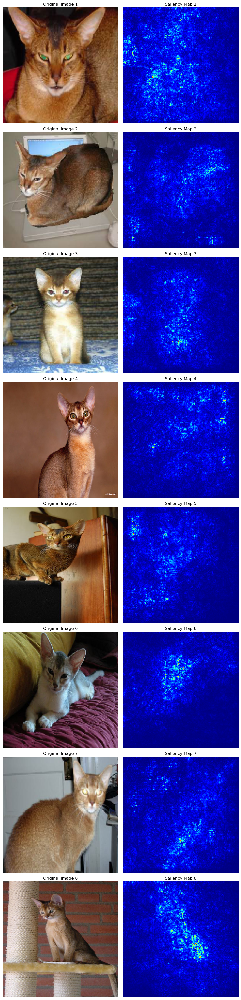

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

# Function to generate the saliency map for a single image
def generate_saliency_map(model, image, class_idx):
    # Convert the image into a tensor and watch for gradients
    image_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
    image_tensor = tf.expand_dims(image_tensor, axis=0)  # Add batch dimension

    with tf.GradientTape() as tape:
        # Watch the image tensor
        tape.watch(image_tensor)
        # Forward pass through the model to get predictions
        predictions = model(image_tensor)
        # Get the score of the target class (class_idx)
        score = predictions[:, class_idx]

    # Compute the gradient of the score w.r.t. the input image
    gradient = tape.gradient(score, image_tensor)

    # Take the absolute value of the gradient to get the magnitude of influence
    saliency = tf.abs(gradient)
    saliency = np.max(saliency, axis=-1)  # Reduce over color channels to get a single map

    return saliency[0]  # Remove the batch dimension

# Plot 8 images with their saliency maps side by side (8x2 grid)
fig, axes = plt.subplots(8, 2, figsize=(10, 40))  # 8 rows and 2 columns

for i in range(8):
    # Select the i-th image from the batch
    image = I[i]
    
    # Get the predicted class for the image
    image_expanded = np.expand_dims(image, axis=0)  # Expand dimensions for the model
    pred_class = np.argmax(custom_cnn_model.predict(image_expanded, verbose=0))
    
    # Generate saliency map for the predicted class
    saliency_map = generate_saliency_map(custom_cnn_model, image, pred_class)
    
    # Plot the original image in the left column
    axes[i, 0].imshow(image)
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the saliency map in the right column
    axes[i, 1].imshow(saliency_map, cmap='jet')  # Use a heatmap to visualize saliency
    axes[i, 1].set_title(f"Saliency Map {i+1}")
    axes[i, 1].axis('off')  # Turn off axis for a cleaner look

# Adjust the layout so that it looks nice
plt.tight_layout()
plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

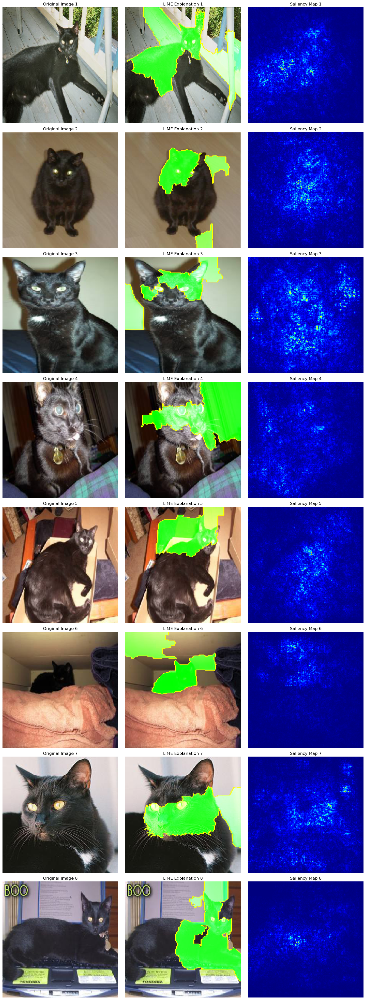

In [66]:
import numpy as np
import lime
import lime.lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import tensorflow as tf

# Function to generate the saliency map for a single image
def generate_saliency_map(model, image, class_idx):
    # Convert the image into a tensor and watch for gradients
    image_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
    image_tensor = tf.expand_dims(image_tensor, axis=0)  # Add batch dimension

    with tf.GradientTape() as tape:
        # Watch the image tensor
        tape.watch(image_tensor)
        # Forward pass through the model to get predictions
        predictions = model(image_tensor)
        # Get the score of the target class (class_idx)
        score = predictions[:, class_idx]

    # Compute the gradient of the score w.r.t. the input image
    gradient = tape.gradient(score, image_tensor)

    # Take the absolute value of the gradient to get the magnitude of influence
    saliency = tf.abs(gradient)
    saliency = np.max(saliency, axis=-1)  # Reduce over color channels to get a single map

    return saliency[0]  # Remove the batch dimension

# Initialize the LIME ImageExplainer
explainer = lime.lime_image.LimeImageExplainer()

# Define a function that takes an image and returns the prediction
def predict_fn(images):
    return custom_cnn_model.predict(images, verbose=0)

# Get a batch of images from your test generator
I, y = next(test_gen_m)  # Assuming test_gen yields a batch of images

# Create a figure to hold the subplots for 8 images (3 columns: original, LIME explanation, and saliency map)
fig, axes = plt.subplots(8, 3, figsize=(15, 40))  # 8 rows and 3 columns

# Loop through the first 8 images from the batch
for i in range(8):
    image = I[i]  # Select the i-th image from the batch
    image_expanded = np.expand_dims(image, axis=0)  # Expand dimensions for the model
    
    # Get the predicted class for the image
    pred_class = np.argmax(custom_cnn_model.predict(image_expanded, verbose=0))
    
    # Generate LIME explanation
    explanation = explainer.explain_instance(image, predict_fn, top_labels=5, hide_color=0, num_samples=1000)
    temp, mask = explanation.get_image_and_mask(pred_class, positive_only=True, num_features=5, hide_rest=False)
    
    # Generate saliency map for the predicted class
    saliency_map = generate_saliency_map(custom_cnn_model, image, pred_class)
    
    # Plot the original image in the first column
    axes[i, 0].imshow(image)
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the LIME explanation in the second column
    axes[i, 1].imshow(mark_boundaries(temp, mask))
    axes[i, 1].set_title(f"LIME Explanation {i+1}")
    axes[i, 1].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the saliency map in the third column
    axes[i, 2].imshow(saliency_map, cmap='jet')  # Use a heatmap to visualize saliency
    axes[i, 2].set_title(f"Saliency Map {i+1}")
    axes[i, 2].axis('off')  # Turn off axis for a cleaner look

# Adjust the layout so that it looks nice
plt.tight_layout()
plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

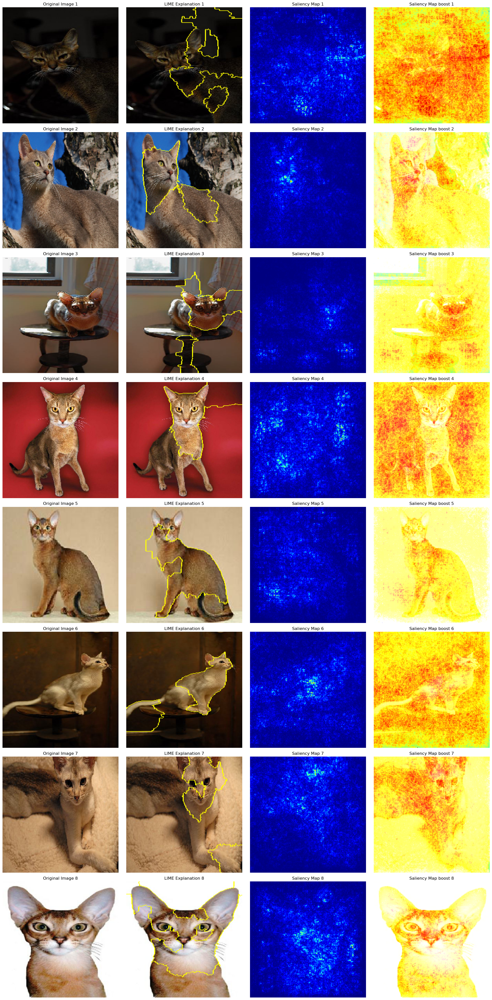

In [28]:
import numpy as np
import lime
import lime.lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import tensorflow as tf
from skimage.transform import resize

# Function to generate the saliency map for a single image
def generate_saliency_map(model, image, class_idx):
    # Convert the image into a tensor and watch for gradients
    image_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
    image_tensor = tf.expand_dims(image_tensor, axis=0)  # Add batch dimension

    with tf.GradientTape() as tape:
        # Watch the image tensor
        tape.watch(image_tensor)
        # Forward pass through the model to get predictions
        predictions = model(image_tensor)
        # Get the score of the target class (class_idx)
        score = predictions[:, class_idx]

    # Compute the gradient of the score w.r.t. the input image
    gradient = tape.gradient(score, image_tensor)

    # Take the absolute value of the gradient to get the magnitude of influence
    saliency = tf.abs(gradient)
    saliency = np.max(saliency, axis=-1)  # Reduce over color channels to get a single map

    return saliency[0]  # Remove the batch dimension

# Function to overlay the saliency map on the original image
def overlay_heatmap_on_image(image, heatmap, alpha=1, intensity_factor=0.1):
    # Normalize heatmap to [0, 1]
    heatmap = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap) + 1e-8)
    
    # Enhance heatmap intensity by applying a power function
    heatmap = np.power(heatmap, intensity_factor)  # Raising to a power increases density
    
    # Convert heatmap to [0, 255] range
    heatmap = np.uint8(255 * heatmap)
    
    # Resize the heatmap with anti-aliasing for smoothness
    heatmap = resize(heatmap, (image.shape[0], image.shape[1]), anti_aliasing=True)
    
    # Apply 'jet' colormap
    heatmap = plt.cm.jet(heatmap)[:, :, :3]  # Discard the alpha channel
    
    # Normalize the image if needed
    if image.max() > 1:
        image = image / 255.0
    
    # Superimpose the heatmap on the original image with transparency (alpha blending)
    superimposed_img = heatmap * alpha + image
    superimposed_img = np.clip(superimposed_img, 0, 1)  # Clip values to valid range
    
    return superimposed_img


# Initialize the LIME ImageExplainer
explainer = lime.lime_image.LimeImageExplainer()

# Define a function that takes an image and returns the prediction
def predict_fn(images):
    return custom_cnn_model.predict(images, verbose=0)

# Get a batch of images from your test generator
I, y = next(test_gen_m)  # Assuming test_gen yields a batch of images

# Create a figure to hold the subplots for 8 images (4 columns: original, LIME, saliency, overlayed heatmap)
fig, axes = plt.subplots(8, 4, figsize=(20, 40))  # 8 rows and 4 columns

# Loop through the first 8 images from the batch
for i in range(8):
    image = I[i]  # Select the i-th image from the batch
    image_expanded = np.expand_dims(image, axis=0)  # Expand dimensions for the model
    
    # Get the predicted class for the image
    pred_class = np.argmax(custom_cnn_model.predict(image_expanded, verbose=0))
    
    # Generate LIME explanation
    explanation = explainer.explain_instance(image, predict_fn, top_labels=5, hide_color=0, num_samples=1000)
    temp, mask = explanation.get_image_and_mask(pred_class, positive_only=True, num_features=5, hide_rest=False)
    
    # Generate saliency map for the predicted class
    saliency_map = generate_saliency_map(custom_cnn_model, image, pred_class)
    
    # Normalize the saliency map to range [0, 1]
    saliency_map = (saliency_map - saliency_map.min()) / (saliency_map.max() - saliency_map.min())

    # Superimpose the heatmap on the original image
    saliency_map_boost = overlay_heatmap_on_image(image, saliency_map)
    
    # Plot the original image in the first column
    axes[i, 0].imshow(image)
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the LIME explanation in the second column
    axes[i, 1].imshow(mark_boundaries(temp, mask))
    axes[i, 1].set_title(f"LIME Explanation {i+1}")
    axes[i, 1].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the saliency map in the third column
    axes[i, 2].imshow(saliency_map, cmap='jet')  # Use a heatmap to visualize saliency
    axes[i, 2].set_title(f"Saliency Map {i+1}")
    axes[i, 2].axis('off')  # Turn off axis for a cleaner look

    # Plot the superimposed heatmap in the fourth column
    axes[i, 3].imshow(saliency_map_boost)
    axes[i, 3].set_title(f"Saliency Map boost {i+1}")
    axes[i, 3].axis('off')  # Turn off axis for a cleaner look

# Adjust the layout so that it looks nice
plt.tight_layout()
plt.show()


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

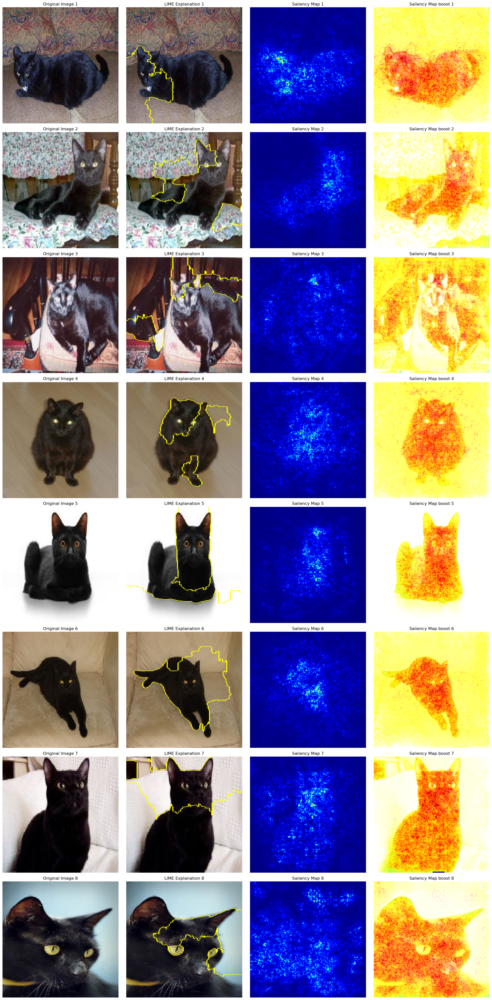

In [120]:
import numpy as np
import lime
import lime.lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import tensorflow as tf
from skimage.transform import resize

# Function to generate the saliency map for a single image
def generate_saliency_map(model, image, class_idx):
    # Convert the image into a tensor and watch for gradients
    image_tensor = tf.convert_to_tensor(image, dtype=tf.float32)
    image_tensor = tf.expand_dims(image_tensor, axis=0)  # Add batch dimension

    with tf.GradientTape() as tape:
        # Watch the image tensor
        tape.watch(image_tensor)
        # Forward pass through the model to get predictions
        predictions = model(image_tensor)
        # Get the score of the target class (class_idx)
        score = predictions[:, class_idx]

    # Compute the gradient of the score w.r.t. the input image
    gradient = tape.gradient(score, image_tensor)

    # Take the absolute value of the gradient to get the magnitude of influence
    saliency = tf.abs(gradient)
    saliency = np.max(saliency, axis=-1)  # Reduce over color channels to get a single map

    return saliency[0]  # Remove the batch dimension

# Function to overlay the saliency map on the original image
def overlay_heatmap_on_image(image, heatmap, alpha=1, intensity_factor=0.1):
    # Normalize heatmap to [0, 1]
    heatmap = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap) + 1e-8)
    
    # Enhance heatmap intensity by applying a power function
    heatmap = np.power(heatmap, intensity_factor)  # Raising to a power increases density
    
    # Convert heatmap to [0, 255] range
    heatmap = np.uint8(255 * heatmap)
    
    # Resize the heatmap with anti-aliasing for smoothness
    heatmap = resize(heatmap, (image.shape[0], image.shape[1]), anti_aliasing=True)
    
    # Apply 'jet' colormap
    heatmap = plt.cm.jet(heatmap)[:, :, :3]  # Discard the alpha channel
    
    # Normalize the image if needed
    if image.max() > 1:
        image = image / 255.0
    
    # Superimpose the heatmap on the original image with transparency (alpha blending)
    superimposed_img = heatmap * alpha + image
    superimposed_img = np.clip(superimposed_img, 0, 1)  # Clip values to valid range
    
    return superimposed_img


# Initialize the LIME ImageExplainer
explainer = lime.lime_image.LimeImageExplainer()

# Define a function that takes an image and returns the prediction
def predict_fn(images):
    return custom_cnn_model.predict(images, verbose=0)

# Get a batch of images from your test generator
I, y = next(test_gen_m)  # Assuming test_gen yields a batch of images

# Create a figure to hold the subplots for 8 images (4 columns: original, LIME, saliency, overlayed heatmap)
fig, axes = plt.subplots(8, 4, figsize=(20, 40))  # 8 rows and 4 columns

# Loop through the first 8 images from the batch
for i in range(8):
    image = I[i]  # Select the i-th image from the batch
    image_expanded = np.expand_dims(image, axis=0)  # Expand dimensions for the model
    
    # Get the predicted class for the image
    pred_class = np.argmax(custom_cnn_model.predict(image_expanded, verbose=0))
    
    # Generate LIME explanation
    explanation = explainer.explain_instance(image, predict_fn, top_labels=5, hide_color=0, num_samples=1000)
    temp, mask = explanation.get_image_and_mask(pred_class, positive_only=True, num_features=5, hide_rest=False)
    
    # Generate saliency map for the predicted class
    saliency_map = generate_saliency_map(custom_cnn_model, image, pred_class)
    
    # Normalize the saliency map to range [0, 1]
    saliency_map = (saliency_map - saliency_map.min()) / (saliency_map.max() - saliency_map.min())

    # Superimpose the heatmap on the original image
    saliency_map_boost = overlay_heatmap_on_image(image, saliency_map)
    
    # Plot the original image in the first column
    axes[i, 0].imshow(image)
    axes[i, 0].set_title(f"Original Image {i+1}")
    axes[i, 0].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the LIME explanation in the second column
    axes[i, 1].imshow(mark_boundaries(temp, mask))
    axes[i, 1].set_title(f"LIME Explanation {i+1}")
    axes[i, 1].axis('off')  # Turn off axis for a cleaner look
    
    # Plot the saliency map in the third column
    axes[i, 2].imshow(saliency_map, cmap='jet')  # Use a heatmap to visualize saliency
    axes[i, 2].set_title(f"Saliency Map {i+1}")
    axes[i, 2].axis('off')  # Turn off axis for a cleaner look

    # Plot the superimposed heatmap in the fourth column
    axes[i, 3].imshow(saliency_map_boost)
    axes[i, 3].set_title(f"Saliency Map boost {i+1}")
    axes[i, 3].axis('off')  # Turn off axis for a cleaner look

# Adjust the layout so that it looks nice
plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step




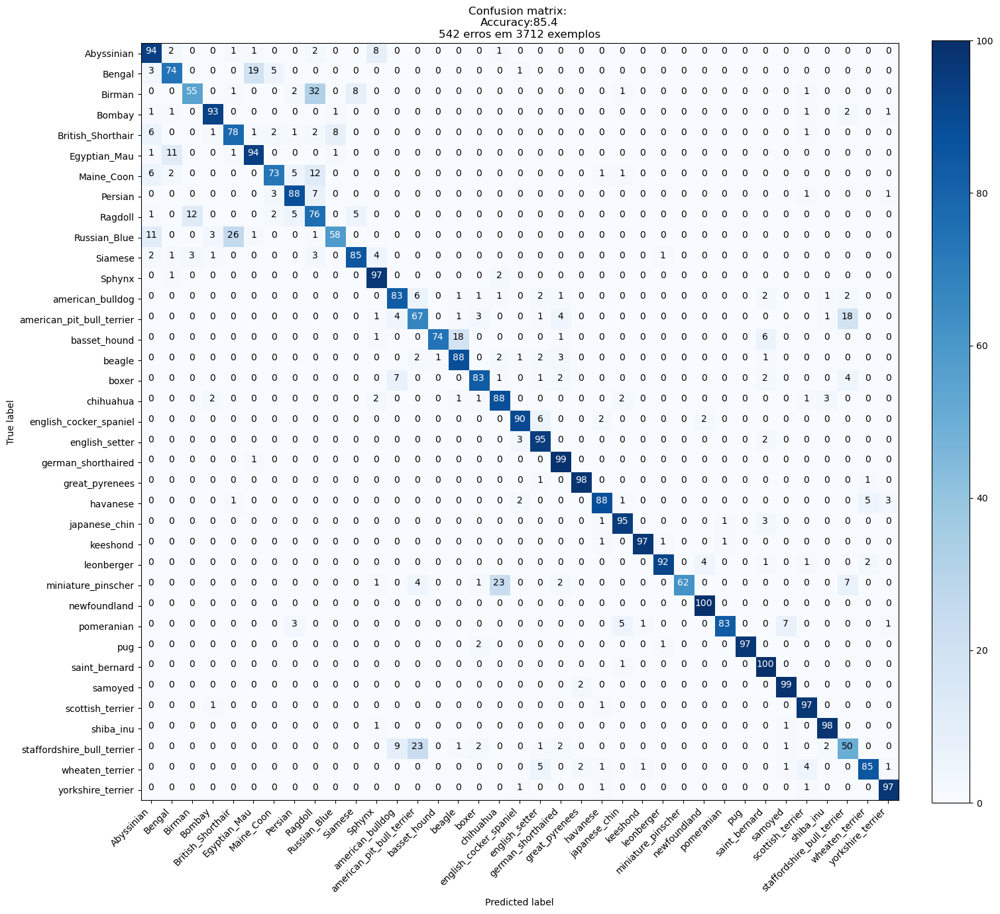

In [114]:
y_true, y_pred = predict_func(multi_cnn_resnet, test_gen_m,unique_breeds, size=test_gen_m.n, bSize=batch_size_test, figsize_val=15)

In [115]:
bad_predictions = (y_pred.argmax(axis=0) != y_true)
print('Bad predictions:', sum(bad_predictions))

Bad predictions: 3712
